# Part I - Loading the ESDC

In this tutorial, we will walk through how one can access the ESDC. Fortunately, we have 2 ways: locally and through the internet. I have already personally downloading the cubes to our in-house server. But for reproducibility purposes, the cubes can be accessed externally as well. So we will walk-through the two ways that this is possible.

In [1]:
import sys, os
from pyprojroot import here
root = here(project_files=[".here"])
sys.path.append(str(here()))

import pathlib

from src.data.esdc import get_dataset
from src.features.utils import subset_indices
from src.features.temporal import select_period, TimePeriod, remove_climatology
from src.features.density import get_density_cubes
from sklearn.preprocessing import StandardScaler
import h5py

DATA_PATH = pathlib.Path("/media/disk/databases/ESDC/")
RAW_PATH = pathlib.Path("/media/disk/erc/papers/2020_rbig_eo/raw")

FIG_PATH = pathlib.Path(str(here()), 'reports/figures/spa_temp')

In [110]:
sub_df = density_cube_df[:100]
# sub_df = sub_df.set_index(['time', 'lat', 'lon'])
columns = sub_df.columns
var_cols = columns[3:]
print(sub_df.shape)
sub_df.head()

(100, 15)


,time,lat,lon,var_x0,var_x1,var_x2,var_x3,var_x4,var_x5,var_x6,var_x7,var_x8,var_x9,var_x10,var_x11
0,1038700800000000000,79.875,-89.125,0.004273,0.024427,-0.012343,0.056996,-0.031847,0.013936,-0.162324,-0.164467,-0.086383,0.018744,-0.012044,-0.035435
1,1038700800000000000,79.875,-88.875,-0.005709,0.019210,-0.017520,0.045110,-0.023902,0.055984,-0.210263,-0.097695,-0.075310,0.016783,0.002746,-0.020299
2,1038700800000000000,79.875,-88.625,0.000179,0.007378,-0.007604,0.016215,-0.023276,0.034866,-0.359454,-0.166136,-0.135427,-0.007147,-0.000528,-0.003227
3,1038700800000000000,79.875,-88.375,-0.001557,0.001034,-0.000634,0.016339,-0.015949,-0.027261,-0.305156,-0.120008,-0.144783,-0.021047,0.001466,0.000247
4,1038700800000000000,79.875,-88.125,-0.001462,0.000015,-0.002514,0.001688,-0.011934,-0.122483,-0.302527,-0.189061,-0.125884,-0.020886,-0.000484,0.002235


In [111]:
value_vars = np.arange(1,len(columns)-3)

In [122]:
df["variable"].unique().tolist()

[0, 1, 4, 5, 6, 7, 8, 9, 10, 11, 2, 3]

In [118]:
df = pd.melt(sub_df, value_name='data', id_vars=['time', 'lon', 'lat'])
df["variable"] = df["variable"].astype('category').cat.codes.astype(np.int)
df.head()

,time,lon,lat,variable,data
0,1038700800000000000,-89.125,79.875,0,0.004273
1,1038700800000000000,-88.875,79.875,0,-0.005709
2,1038700800000000000,-88.625,79.875,0,0.000179
3,1038700800000000000,-88.375,79.875,0,-0.001557
4,1038700800000000000,-88.125,79.875,0,-0.001462


In [20]:
!ls /media/disk/erc/papers/2020_rbig_eo/raw/
# !mkdir /media/disk/erc/papers/2020_rbig_eo/raw/resampled

cubes					 leaf_area_index_d11_2010.h5
gross_primary_productivity_d11_2010.h5	 leaf_area_index_d112_2010.h5
gross_primary_productivity_d112_2010.h5  leaf_area_index_d112.h5
gross_primary_productivity_d112.h5	 leaf_area_index_d11.h5
gross_primary_productivity_d11.h5	 leaf_area_index_d146_2010.h5
gross_primary_productivity_d146_2010.h5  leaf_area_index_d24_2010.h5
gross_primary_productivity_d24_2010.h5	 leaf_area_index_d24.h5
gross_primary_productivity_d24.h5	 leaf_area_index_d32_2010.h5
gross_primary_productivity_d32_2010.h5	 leaf_area_index_d32.h5
gross_primary_productivity_d32.h5	 leaf_area_index_d36_2010.h5
gross_primary_productivity_d36_2010.h5	 leaf_area_index_d41_2010.h5
gross_primary_productivity_d41_2010.h5	 leaf_area_index_d41.h5
gross_primary_productivity_d41.h5	 leaf_area_index_d71_2010.h5
gross_primary_productivity_d71_2010.h5	 resampled


## Year 2010

In [29]:
dims = [
    (1,46), 
    (7,1), 
    (3,6), 
]
variables = [
    'gross_primary_productivity', 
    'leaf_area_index'
]

for ivariable in variables:
    for idims in dims:
        
        save_name = RAW_PATH.joinpath(f"cubes/{ivariable}_d{idims[0]}{idims[1]}_2010")
        print(save_name)
        # get datacube
        datacube = get_dataset()[ivariable]
        
#         # resample
#         datacube = datacube.resample(time='1MS').mean()
        
        # remove climatology
        datacube, _ = remove_climatology(datacube)
        
        # select period
        datacube = select_period(xr_data=datacube, period=TimePeriod(name="2010", start="Jan-2010", end="Dec-2010"))
        
        # density cubes
        density_cube_df = get_density_cubes(
            data=datacube, spatial=idims[0], temporal=idims[1],
        )
        density_cube_df.reset_index(inplace=True)
#         with pd.HDFStore(str(save_name), mode='w') as f:
#             f.append('/data', density_cube_df, format='table', data_columns=density_cube_df.columns)
#         density_cube_df.to_hdf(str(save_name), 'data', mode='w')
#         density_cube_df['time'] = pd.to_datetime(density_cube_df['time'], format='%d/%m/%y %H:%M:%S')#
        density_cube_df['time'] = density_cube_df['time'].values.astype(int)
        with h5py.File(f"{str(save_name)}.h5", 'w') as f:
            f.create_dataset('data', data=density_cube_df.iloc[:, 3:].values, dtype=density_cube_df.iloc[:, 3:].values.dtype)
            f.create_dataset('time', data=density_cube_df.iloc[:, 0].values, dtype=density_cube_df.iloc[:, 0].values.dtype)
            f.create_dataset('lat', data=density_cube_df.iloc[:, 1].values, dtype=density_cube_df.iloc[:, 1].values.dtype)
            f.create_dataset('lon', data=density_cube_df.iloc[:, 2].values, dtype=density_cube_df.iloc[:, 2].values.dtype)
#             density_cube_df.to_csv(str(save_name))
#         with h5py.File(f"{str(save_name)}.h5", 'w') as f:
#             density_cubes
        del density_cube_df
        del datacube
#         break
#         break
#     break

/media/disk/erc/papers/2020_rbig_eo/raw/cubes/gross_primary_productivity_d146_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/cubes/gross_primary_productivity_d71_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/cubes/gross_primary_productivity_d36_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/cubes/leaf_area_index_d146_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/cubes/leaf_area_index_d71_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/cubes/leaf_area_index_d36_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [27]:
with h5py.File(f"/media/disk/erc/papers/2020_rbig_eo/raw/cubes/gross_primary_productivity_d36_2010.h5", 'r') as f:
    print(f['data'])

<HDF5 dataset "data": shape (7582540, 54), type "<f4">


## Year 2010 (Resampled)

In [37]:
dims = [
    (1,12), 
    (4,1), 
    (3,2), 
    (2,4), 
]
variables = [
    'gross_primary_productivity', 
    'leaf_area_index'
]

for ivariable in variables:
    for idims in dims:
        
        save_name = RAW_PATH.joinpath(f"resampled/{ivariable}_d{idims[0]}{idims[1]}_2010")
        print(save_name)
        # get datacube
        datacube = get_dataset()[ivariable]
        
        # resample
        datacube = datacube.resample(time='1MS').mean()
        
        # remove climatology
        datacube, _ = remove_climatology(datacube)
        
        # select period
        datacube = select_period(xr_data=datacube, period=TimePeriod(name="2010", start="Jan-2010", end="Dec-2010"))
        
        # density cubes
        density_cube_df = get_density_cubes(
            data=datacube, spatial=idims[0], temporal=idims[1],
        )
        density_cube_df.reset_index(inplace=True)
#         with pd.HDFStore(str(save_name), mode='w') as f:
#             f.append('/data', density_cube_df, format='table', data_columns=density_cube_df.columns)
#         density_cube_df.to_hdf(str(save_name), 'data', mode='w')
#         density_cube_df['time'] = pd.to_datetime(density_cube_df['time'], format='%d/%m/%y %H:%M:%S')#
        density_cube_df['time'] = density_cube_df['time'].values.astype(int)
        with h5py.File(f"{str(save_name)}.h5", 'w') as f:
            f.create_dataset('data', data=density_cube_df.iloc[:, 3:].values, dtype=density_cube_df.iloc[:, 3:].values.dtype)
            f.create_dataset('time', data=density_cube_df.iloc[:, 0].values, dtype=density_cube_df.iloc[:, 0].values.dtype)
            f.create_dataset('lat', data=density_cube_df.iloc[:, 1].values, dtype=density_cube_df.iloc[:, 1].values.dtype)
            f.create_dataset('lon', data=density_cube_df.iloc[:, 2].values, dtype=density_cube_df.iloc[:, 2].values.dtype)
#             density_cube_df.to_csv(str(save_name))
#         with h5py.File(f"{str(save_name)}.h5", 'w') as f:
#             density_cubes
        del density_cube_df
        del datacube
#         break
#         break
#     break

/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d112_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d41_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d32_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d24_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d112_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d41_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d32_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d24_2010


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [38]:
!ls /media/disk/erc/papers/2020_rbig_eo/raw/cubes
# !rm /media/disk/erc/papers/2020_rbig_eo/raw/cubes/gross_primary_productivity_d146_2001_2011*

gross_primary_productivity_2001_2011.nc  leaf_area_index_2001_2011.nc
gross_primary_productivity_2010.nc	 leaf_area_index_2010.nc
gross_primary_productivity_d146_2010.h5  leaf_area_index_d146_2010.h5
gross_primary_productivity_d36_2010.h5	 leaf_area_index_d36_2010.h5
gross_primary_productivity_d71_2010.h5	 leaf_area_index_d71_2010.h5
land_surface_temperature_2001_2011.nc	 root_moisture_2001_2011.nc
land_surface_temperature_2010.nc	 root_moisture_2010.nc


In [43]:
!ls /media/disk/erc/papers/2020_rbig_eo/raw
# !rm /media/disk/erc/papers/2020_rbig_eo/raw/*.h5
!ls /media/disk/erc/papers/2020_rbig_eo/raw/resampled/

cubes  resampled
gross_primary_productivity_d112_2001_2011.h5  leaf_area_index_d112_2001_2011.h5
gross_primary_productivity_d112_2010.h5       leaf_area_index_d112_2010.h5
gross_primary_productivity_d24_2001_2011.h5   leaf_area_index_d24_2001_2011.h5
gross_primary_productivity_d24_2010.h5	      leaf_area_index_d24_2010.h5
gross_primary_productivity_d32_2001_2011.h5   leaf_area_index_d32_2001_2011.h5
gross_primary_productivity_d32_2010.h5	      leaf_area_index_d32_2010.h5
gross_primary_productivity_d41_2001_2011.h5   leaf_area_index_d41_2001_2011.h5
gross_primary_productivity_d41_2010.h5	      leaf_area_index_d41_2010.h5


In [44]:
!ls /media/disk/erc/papers/2020_rbig_eo/raw/cubes/

gross_primary_productivity_2001_2011.nc  leaf_area_index_2001_2011.nc
gross_primary_productivity_2010.nc	 leaf_area_index_2010.nc
gross_primary_productivity_d146_2010.h5  leaf_area_index_d146_2010.h5
gross_primary_productivity_d36_2010.h5	 leaf_area_index_d36_2010.h5
gross_primary_productivity_d71_2010.h5	 leaf_area_index_d71_2010.h5
land_surface_temperature_2001_2011.nc	 root_moisture_2001_2011.nc
land_surface_temperature_2010.nc	 root_moisture_2010.nc


In [53]:
density_cube_df.iloc[:, 3:].values, type(density_cube_df.iloc[:, 0].values[0])

(array([[ 4.2727739e-03],
        [-5.7088472e-03],
        [ 1.7870963e-04],
        ...,
        [-4.6911526e-01],
        [-2.9200697e-01],
        [-7.8010249e-01]], dtype=float32),
 str)

## Year 2001-2011 (Resampled)

In [39]:
dims = [
    (1,12), 
    (4,1), 
    (3,2), 
    (2,4), 
]
variables = [
    'gross_primary_productivity', 
    'leaf_area_index'
]

for ivariable in variables:
    for idims in dims:
        
        save_name = RAW_PATH.joinpath(f"resampled/{ivariable}_d{idims[0]}{idims[1]}_2001_2011")
        print(save_name)
        # get datacube
        datacube = get_dataset()[ivariable]
        
        # resample
        datacube = datacube.resample(time='1MS').mean()
        
        # remove climatology
        datacube, _ = remove_climatology(datacube)
        
        # select period
        datacube = select_period(xr_data=datacube, period=TimePeriod(name="2001_2011", start="Jan-2001", end="Dec-2011"))
        
        # density cubes
        density_cube_df = get_density_cubes(
            data=datacube, spatial=idims[0], temporal=idims[1],
        )
        density_cube_df.reset_index(inplace=True)
#         with pd.HDFStore(str(save_name), mode='w') as f:
#             f.append('/data', density_cube_df, format='table', data_columns=density_cube_df.columns)
#         density_cube_df.to_hdf(str(save_name), 'data', mode='w')
#         density_cube_df['time'] = pd.to_datetime(density_cube_df['time'], format='%d/%m/%y %H:%M:%S')#
        density_cube_df['time'] = density_cube_df['time'].values.astype(int)
        with h5py.File(f"{str(save_name)}.h5", 'w') as f:
            f.create_dataset('data', data=density_cube_df.iloc[:, 3:].values, dtype=density_cube_df.iloc[:, 3:].values.dtype)
            f.create_dataset('time', data=density_cube_df.iloc[:, 0].values, dtype=density_cube_df.iloc[:, 0].values.dtype)
            f.create_dataset('lat', data=density_cube_df.iloc[:, 1].values, dtype=density_cube_df.iloc[:, 1].values.dtype)
            f.create_dataset('lon', data=density_cube_df.iloc[:, 2].values, dtype=density_cube_df.iloc[:, 2].values.dtype)
#             density_cube_df.to_csv(str(save_name))
#         with h5py.File(f"{str(save_name)}.h5", 'w') as f:
#             density_cubes
        del density_cube_df
        del datacube
#         break
#         break
#     break

/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d112_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d41_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d32_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/gross_primary_productivity_d24_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d112_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d41_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d32_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


/media/disk/erc/papers/2020_rbig_eo/raw/resampled/leaf_area_index_d24_2001_2011


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [4]:
dims = [(1,12), (1,1), (4,1), (3,2), (2,4)]
variables = ['gross_primary_productivity', 'leaf_area_index']

for ivariable in variables:
    for idims in dims:
        
        save_name = RAW_PATH.joinpath(f"{ivariable}_d{idims[0]}{idims[1]}")
        print(save_name)
        # get datacube
        datacube = get_dataset()[ivariable]
        
        # resample
        datacube = datacube.resample(time='1MS').mean()
        
#         # remove climatology
#         datacube, _ = remove_climatology(datacube)
        
        # select period
        datacube = select_period(xr_data=datacube, period=TimePeriod(name="2002_2010", start="Jan-2002", end="Dec-2010"))
        
        
        # density cubes
        density_cube_df = get_density_cubes(
            data=datacube, spatial=idims[0], temporal=idims[1],
        )
        density_cube_df.reset_index(inplace=True)
        idx = subset_indices(density_cube_df.values, 1000, 123)
        print(idx.shape)
        density_cube_df = density_cube_df[idx]
#         with pd.HDFStore(str(save_name), mode='w') as f:
#             f.append('/data', density_cube_df, format='table', data_columns=density_cube_df.columns)
#         density_cube_df.to_hdf(str(save_name), 'data', mode='w')
#         density_cube_df['time'] = pd.to_datetime(density_cube_df['time'], format='%d/%m/%y %H:%M:%S')#
        density_cube_df['time'] = density_cube_df['time'].values.astype(int)
        
        # melt columns to index
        density_cube_df = pd.melt(density_cube_df, value_name='data', id_vars=['time', 'lon', 'lat'])
        
        # convert feature names to variables
        density_cube_df["variable"] = density_cube_df["variable"].astype('category').cat.codes.astype(np.int)
        
        # convert to xarray
        density_cube_df = density_cube_df.set_index(['time', 'lat', 'lon', 'variable'])
        datacube = density_cube_df.to_xarray()
        break
    break
        

/media/disk/erc/papers/2020_rbig_eo/raw/gross_primary_productivity_d112


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


KeyboardInterrupt: 

In [ ]:
datacube

In [ ]:
datacube.data.sel(variable=0).plot()

In [56]:
density_cube_df

NameError: name 'density_cube_df' is not defined

In [ ]:
def datenum64_2_timestamp(dn):
    return None

In [23]:
from datetime import datetime, timedelta

def datetime2matlabdn(dt):
    ord = dt.toordinal()
    mdn = dt + timedelta(days = 366)
    frac = (dt-datetime(dt.year,dt.month,dt.day,0,0,0)).seconds / (24.0 * 60.0 * 60.0)
    return mdn.toordinal() + frac

def npdatetime64_2_matlabdn(dn):
    dt = datetime.utcnow()
    dt64 = np.datetime64(dt)
    ts = (dt64 - np.datetime64(dn)) / np.timedelta64(1, 's')
    return ts

In [25]:
type(npdatetime64_2_matlabdn(density_cube_df.iloc[:, 0].values[0]))

numpy.float64

In [65]:
with h5py.File(str(save_name), mode='r') as f:
    print(f.keys())
    print(f['data'])
    print(f['lat'])
    print(f['lon'])
    print(f['time'])

<KeysViewHDF5 ['data', 'lat', 'lon', 'time']>
<HDF5 dataset "data": shape (35439882, 12), type "<f4">
<HDF5 dataset "lat": shape (35439882,), type "<f8">
<HDF5 dataset "lon": shape (35439882,), type "<f8">
<HDF5 dataset "time": shape (35439882,), type "<i8">


In [11]:
RAW_PATH

PosixPath('/media/disk/erc/papers/2020_rbig_eo/raw')

In [34]:
!ls /media/disk/erc/papers/2020_rbig_eo/raw
# !rm /media/disk/erc/papers/2020_rbig_eo/raw/*

In [2]:
!ls /media/disk/databases/

ASTER					    LSASAF
BACI-CABLAB				    MODIS
BBDD_video_image			    MODIS_IGBP_LandCover
BELMANIP				    MULTILAI
Belmanip2_VGT_MOD_CYC_2003_2007_v2	    NEUROEXPLORA_2016
BigEarth				    NEUROEXPLORA_2018
BLACKCARBON				    NEUROEXPLORA_2019
C2X					    NWPU-RESISC45
CARTOGRAFICO				    OCEANCLORO
CASIAHS					    ODE_data
CAUSALITY				    PatternNet
CHRISLAI				    PHENOCAM
CMIX					    PhiLab_UNOSAT_challenge
DROUGHT					    PROBAV_CLOUDS
EMULATEDS2				    PROSAIL_EMULATOR_CAUSAL
ESACCI-LandCover			    PROSPECT
ESDC					    S1S2Luca
EuroSAT					    S1S2Transfer
FLUXCOM					    SEN12MS
GF_Landsat_2013_Irrigated_project	    SENTINEL2_CLOUDS
GFZSIF					    SHAPEFILES
Global_TRY_maps_V1			    SIx
HL_20151110_C2A_noFlu_spec_Rrs_norm_10.txt  SMADI
HYPERLABELME				    SMOS-IC
HYPERLABELME_OLD_DATA			    SMOS_SSSMed
IASI_data				    SMOS_VOD
IASI Tim				    SPARC
iclradiant				    StreamFlow
IGARSS2019				    SYKE
indian_wheat_yield			    TCEP_CAUSAL
Inputs_GLOBAL_Trait_spatialization3km	   

## Method I - Online

For this first example, we will load the cubes from the server. Then we can view the cubes.

In [2]:
ONLINE_CUBE = "https://obs.eu-de.otc.t-systems.com"
CUBE = "obs-esdc-v2.1"
LOW_RES = "obs-esdc-v2.1/esdc-8d-0.25deg-1x720x1440-2.1.0.zarr"
CUBE_VERSION = "2.1.0"
EXT = ".zarr"
ESDC_PATH = "obs-esdc-v2.1/esdc-8d-1x720x1440-2.1.0.zarr"
INFO_EARTH = [
    "gross_primary_productivity",
    "root_moisture",
    "precipitation",
    "leaf_area_index",
    "land_surface_temperature",
]

path = (
    f"{ONLINE_CUBE}/{LOW_RES}"
)

https://obs.eu-de.otc.t-systems.com/obs-esdc-v2.0.0/esdc-8d-0.25deg-1x720x1440-2.0.0.zarr

In [3]:
path

'https://obs.eu-de.otc.t-systems.com/obs-esdc-v2.1/esdc-8d-0.25deg-1x720x1440-2.1.0.zarr'

In [3]:
raw_path = "/media/disk/erc/papers/2020_rbig_eo"


In [5]:
!mkdir $raw_path/raw

In [4]:
t = open_cube(str(path))

In [5]:
# load cube from bit bucket
cube_from_s3_bucket = open_cube("https://obs.eu-de.otc.t-systems.com/obs-esdc-v2.0.0/esdc-8d-0.25deg-1x720x1440-2.0.0.zarr")

In [6]:
cube_from_s3_bucket

<xarray.Dataset>
Dimensions:                            (bnds: 2, lat: 720, lon: 1440, time: 1702)
Coordinates:
  * lat                                (lat) float32 89.875 89.625 ... -89.875
    lat_bnds                           (lat, bnds) float32 dask.array<chunksize=(720, 2), meta=np.ndarray>
  * lon                                (lon) float32 -179.875 ... 179.875
    lon_bnds                           (lon, bnds) float32 dask.array<chunksize=(1440, 2), meta=np.ndarray>
  * time                               (time) datetime64[ns] 1980-01-05 ... 2016-12-30
    time_bnds                          (time, bnds) datetime64[ns] dask.array<chunksize=(1702, 2), meta=np.ndarray>
Dimensions without coordinates: bnds
Data variables:
    Rg                                 (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_1600     (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_550      (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_670      (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_870      (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    air_temperature_2m                 (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    analysed_sst                       (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    bare_soil_evaporation              (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    black_sky_albedo                   (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    black_sky_albedo_avhrr             (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    burnt_area                         (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    c_emissions                        (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cee                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cer                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cfc                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    chlor_a                            (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cot                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    country_mask                       (time, lat, lon) float64 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cph                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cth                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    ctp                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    ctt                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    evaporation                        (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    evaporative_stress                 (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    fapar_tip                          (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    fat_c                              (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    fat_p                              (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    flt_c                              (time, lat, lon) float32 dask.array<chu

And now we can access the variables that we require only, e.g. `gross_primary_productivity` and `soil_moisture`.



In [7]:
variables = [
    'land_surface_temperature',
    'soil_moisture'
]
cubes = cube_from_s3_bucket[variables]
cubes

,Array,Chunk
Bytes,7.06 GB,4.15 MB
Shape,"(1702, 720, 1440)","(1, 720, 1440)"
Count,1703 Tasks,1702 Chunks
Type,float32,numpy.ndarray
,Array,Chunk
Bytes,7.06 GB,4.15 MB
Shape,"(1702, 720, 1440)","(1, 720, 1440)"
Count,1703 Tasks,1702 Chunks
Type,float32,numpy.ndarray


/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


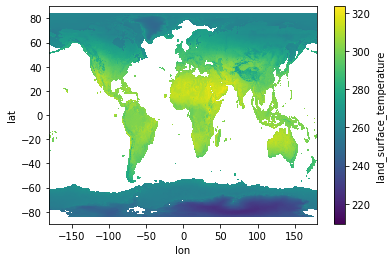

In [9]:
cube_from_s3_bucket.precipitation.mean(dim='time').plot()

In [ ]:
cube_from_s3_bucket.root_moisture.mean(dim='time').plot()

## Method II - Personal Server

Like I said before, I have personally downloaded the cubes on our server so I can access them in house. First let's look at the available cubes.

In [15]:
!ls $DATA_PATH

Cube_2019highColombiaCube_184x120x120.zarr
Cube_2019highColombiaCube_1x3360x2760.zarr
esdc-8d-0.083deg-184x270x270-2.0.0.zarr
esdc-8d-0.083deg-1x2160x4320-2.0.0.zarr
esdc-8d-0.25deg-184x90x90-2.0.0.zarr
esdc-8d-0.25deg-1x720x1440-2.0.0.zarr


We're going to open the datacube with `0.25` degree resolution that is optimized for spatial computations.

In [29]:
# get filename
filename = DATA_PATH.joinpath("esdc-8d-0.25deg-1x720x1440-2.0.0.zarr")

# open datacube
datacube = xr.open_zarr(str(filename))

datacube

<xarray.Dataset>
Dimensions:                            (bnds: 2, lat: 720, lon: 1440, time: 1702)
Coordinates:
  * lat                                (lat) float32 89.875 89.625 ... -89.875
    lat_bnds                           (lat, bnds) float32 dask.array<chunksize=(720, 2), meta=np.ndarray>
  * lon                                (lon) float32 -179.875 ... 179.875
    lon_bnds                           (lon, bnds) float32 dask.array<chunksize=(1440, 2), meta=np.ndarray>
  * time                               (time) datetime64[ns] 1980-01-05 ... 2016-12-30
    time_bnds                          (time, bnds) datetime64[ns] dask.array<chunksize=(1702, 2), meta=np.ndarray>
Dimensions without coordinates: bnds
Data variables:
    Rg                                 (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_1600     (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_550      (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_670      (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    aerosol_optical_thickness_870      (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    air_temperature_2m                 (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    analysed_sst                       (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    bare_soil_evaporation              (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    black_sky_albedo                   (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    black_sky_albedo_avhrr             (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    burnt_area                         (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    c_emissions                        (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cee                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cer                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cfc                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    chlor_a                            (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cot                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    country_mask                       (time, lat, lon) float64 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cph                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    cth                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    ctp                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    ctt                                (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    evaporation                        (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    evaporative_stress                 (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    fapar_tip                          (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    fat_c                              (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    fat_p                              (time, lat, lon) float32 dask.array<chunksize=(1, 720, 1440), meta=np.ndarray>
    flt_c                              (time, lat, lon) float32 dask.array<chu

In [ ]:
# again subset only the ones we require
variables = [
    'gross_primary_productivity',
    'soil_moisture'
]
cubes = datacube[variables]

cubes

And we're done. That's it, there's nothing more to it.

## Experimental Regions

So we're going to be look

In [22]:
# Experiment Functions
from src.data.esdc import get_dataset
from src.features.spatial import select_region, get_spain, get_europe
from src.features.temporal import select_period, TimePeriod

# MATPLOTLIB Settings
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# SEABORN SETTINGS
import seaborn as sns
sns.set_context(context='talk',font_scale=0.7)

import cartopy
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

In [3]:
def plot_xarray_on_map(da, borders=True, coastlines=True, **kwargs):
    """ Plot the LOCATION of an xarray object """

    # create the base layer
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(1, 1, 1, projection=cartopy.crs.Robinson())
    # ax = plt.axes(projection=cartopy.crs.Orthographic(mid_lon, mid_lat))

    vmin = kwargs.pop("vmin", None)
    vmax = kwargs.pop("vmax", None)
    cmap = kwargs.pop("cmap", None)
    cb_title = kwargs.pop("title", '')
    robust = kwargs.pop("robust", None)
    
    
    da.plot(
        ax=ax,
#         transform=cartopy.crs.PlateCarree(),
        vmin=vmin,
        vmax=vmax,
        cmap=cmap,
        robust=robust,
        cbar_kwargs={"shrink": 0.9, "label": cb_title},
    )

    ax.coastlines()
    ax.add_feature(cartopy.feature.BORDERS, linestyle=":")
    ax.add_feature(cartopy.feature.LAKES, facecolor=None)
    fig = plt.gcf()
    ax.outline_patch.set_visible(False)
    return fig, ax

### Spain

#### Low Resolution

/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


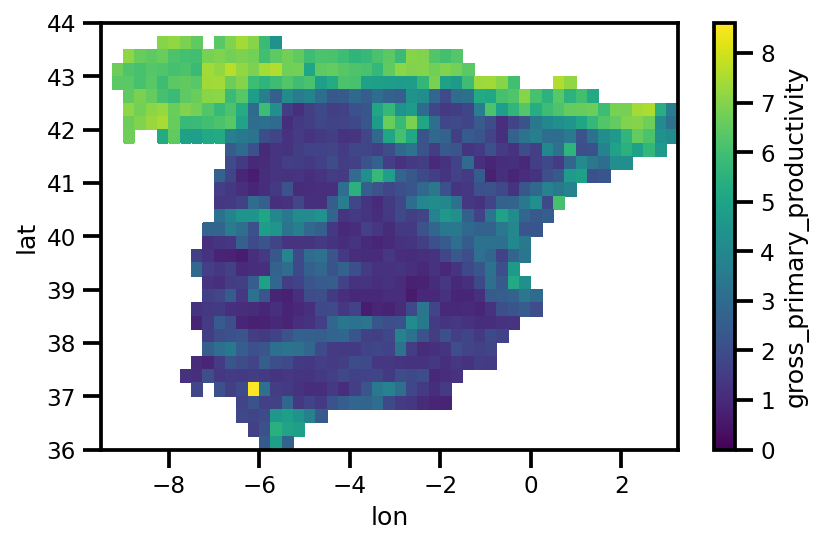

In [28]:
# Get DataCube
variable = 'gross_primary_productivity'
datacube = get_dataset(variable, 'low')


# subset datacube (spatially)
region = get_spain()
datacube = select_region(
    xr_data=datacube, bbox=region
)[variable]

# subset datacube (temporally)
period = TimePeriod(name="201007", start="July-2010", end="July-2010")
datacube = select_period(xr_data=datacube, period=period)

# Plot datacube
# fig, ax = plot_xarray_on_map(datacube.mean(dim='time'))
datacube.mean(dim='time').plot(vmin=0)
plt.tight_layout()
plt.savefig( FIG_PATH.joinpath('demos/spain_lo_gpp.png'))

#### High Resolution

/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


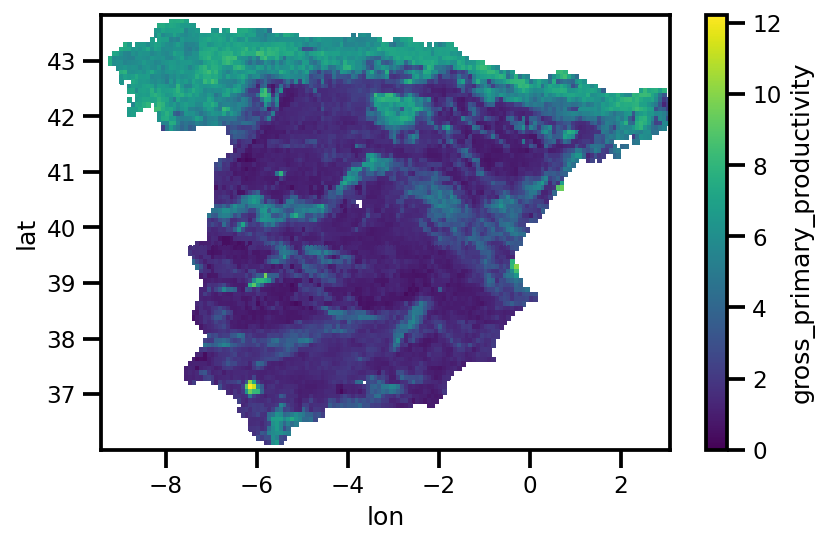

In [29]:
# Get DataCube
variable = 'gross_primary_productivity'
datacube = get_dataset(variable, 'high')


# subset datacube (spatially)
region = get_spain()
datacube = select_region(
    xr_data=datacube, bbox=region
)[variable]

# subset datacube (temporally)
period = TimePeriod(name="201007", start="July-2010", end="July-2010")
datacube = select_period(xr_data=datacube, period=period)

# Plot Datacube
# fig, ax = plot_xarray_on_map(datacube.mean(dim='time'))
datacube.mean(dim='time').plot(vmin=0)
plt.tight_layout()
plt.savefig( FIG_PATH.joinpath('demos/spain_hi_gpp.png'))

### Europe

/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


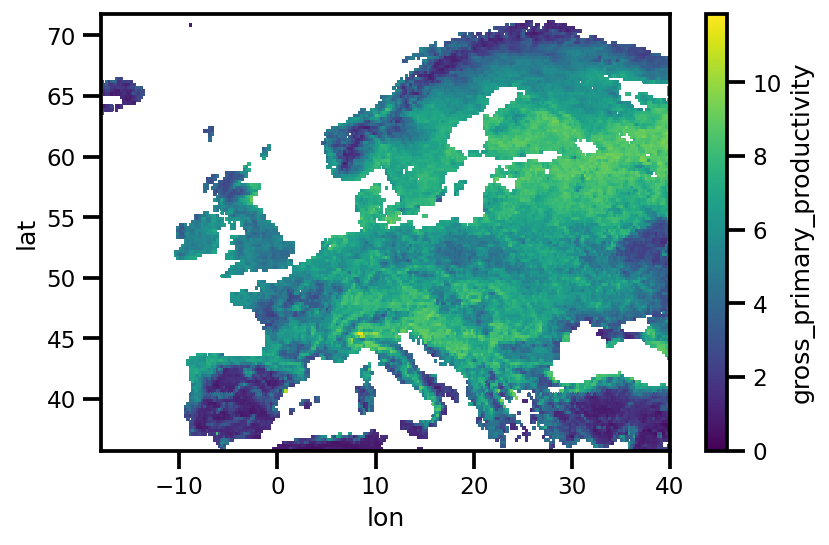

In [30]:
# Get DataCube
variable = 'gross_primary_productivity'
datacube = get_dataset(variable, 'low')


# subset datacube (spatially)
region = get_europe()
datacube = select_region(
    xr_data=datacube, bbox=region
)[variable]

# subset datacube (temporally)
period = TimePeriod(name="201007", start="July-2010", end="July-2010")
datacube = select_period(xr_data=datacube, period=period)

# Plot datacube
# fig, ax = plot_xarray_on_map(datacube.mean(dim='time'))
datacube.mean(dim='time').plot(vmin=0)
plt.tight_layout()
plt.savefig( FIG_PATH.joinpath('demos/europe_lo_gpp.png'))

/home/emmanuel/.conda/envs/rbig_eo/lib/python3.8/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


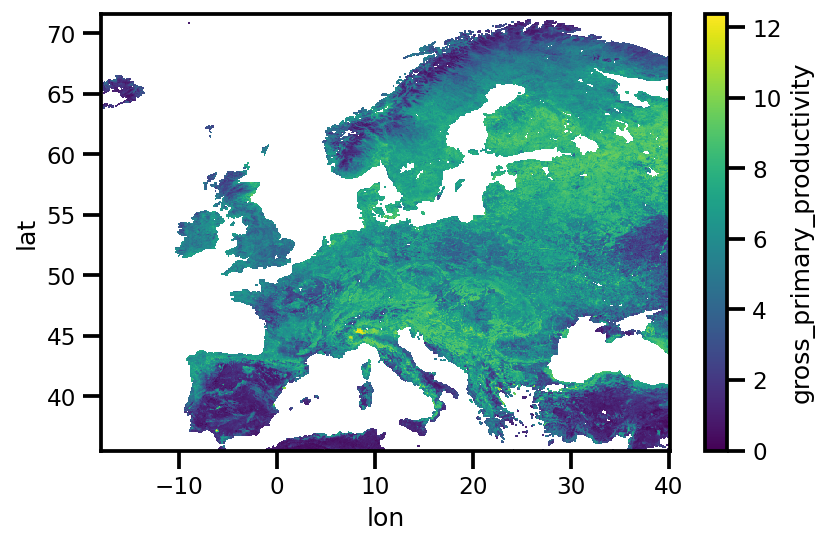

In [31]:
# Get DataCube
variable = 'gross_primary_productivity'
datacube = get_dataset(variable, 'high')


# subset datacube (spatially)
region = get_europe()
datacube = select_region(
    xr_data=datacube, bbox=region
)[variable]

# subset datacube (temporally)
period = TimePeriod(name="201007", start="July-2010", end="July-2010")
datacube = select_period(xr_data=datacube, period=period)

# Plot datacube
# fig, ax = plot_xarray_on_map(datacube.mean(dim='time'))
datacube.mean(dim='time').plot(vmin=0)
plt.tight_layout()
plt.savefig( FIG_PATH.joinpath('demos/europe_hi_gpp.png'))